# Unpaired Image-to-Image Translation using Cycle-Consistent Adversarial Networks

0.1 Imports

In [1]:
import tensorflow as tf
import os
import random
import glob
import numpy as np
import matplotlib.pyplot as plt
import time
from tensorflow.keras.callbacks import LearningRateScheduler, ModelCheckpoint
from tensorflow.keras import mixed_precision


0.2 Utilize GPUs for training

In [2]:
gpus = tf.config.list_physical_devices("GPU")
print("Num GPUs Available: ", len(gpus))

for gpu in gpus:
    tf.config.experimental.set_memory_growth(gpu, True)


Num GPUs Available:  1


0.3 Implement Mirrored strategy(Utilize all available GPU cores) for training

In [ ]:
# Use MirroredStrategy for distributed training on all GPUs
strategy = tf.distribute.MirroredStrategy()
print(f"Number of devices: {strategy.num_replicas_in_sync}")

# global policy for mixed precision
mixed_precision.set_global_policy(mixed_precision.Policy("mixed_float16"))

# Enable XLA (JIT) compilation for optimization
tf.config.optimizer.set_jit(True)


INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
Number of devices: 1
INFO:tensorflow:Mixed precision compatibility check (mixed_float16): OK
Your GPU will likely run quickly with dtype policy mixed_float16 as it has compute capability of at least 7.0. Your GPU: NVIDIA GeForce RTX 4050 Laptop GPU, compute capability 8.9


### 1. Datasets
1.1 Preprocessing functions

In [4]:
def load_image(file_path):
    image = tf.io.read_file(file_path)
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.convert_image_dtype(image, tf.float32)  # Normalize to [0,1]
    return image


def preprocess_image_train(image):
    # Resize to 286x286 and crop to 256x256
    image = tf.image.resize(image, [286, 286])
    image = tf.image.random_crop(image, [256, 256, 3])
    image = tf.image.random_flip_left_right(image)
    image = (image * 2) - 1  # Normalize to [-1, 1]
    return image


def preprocess_image_test(image):
    image = tf.image.resize(image, [256, 256])
    image = (image * 2) - 1  # Normalize to [-1, 1]
    return image


def load_dataset(path_pattern, cache=True):
    file_paths = glob.glob(path_pattern)
    if not file_paths:
        raise ValueError(f"No files found for pattern: {path_pattern}")
    dataset = tf.data.Dataset.from_tensor_slices(file_paths)
    dataset = dataset.map(load_image, num_parallel_calls=tf.data.experimental.AUTOTUNE)

    if cache:
        dataset = dataset.cache()
    dataset = dataset.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)
    return dataset


1.2 Defining dataset paths

In [16]:
# Organization as : dataset/{domain}/train & dataset/{domain}/test
base_path = "C:/Users/rog_z/Downloads/dataset/"

dataset_paths = {
    "horse2zebra": {
        "trainA": os.path.join(base_path, "horse2zebra", "trainA/*"),
        "trainB": os.path.join(base_path, "horse2zebra", "trainB/*"),
        "testA": os.path.join(base_path, "horse2zebra", "testA/*"),
        "testB": os.path.join(base_path, "horse2zebra", "testB/*"),
    },
    "monet2photo": {
        "trainA": os.path.join(base_path, "monet2photo", "trainA/*"),
        "trainB": os.path.join(base_path, "monet2photo", "trainB/*"),
        "testA": os.path.join(base_path, "monet2photo", "testA/*"),
        "testB": os.path.join(base_path, "monet2photo", "testB/*"),
    },
    "summer2winter_yosemite": {
        "trainA": os.path.join(base_path, "summer2winter_yosemite", "trainA/*"),
        "trainB": os.path.join(base_path, "summer2winter_yosemite", "trainB/*"),
        "testA": os.path.join(base_path, "summer2winter_yosemite", "testA/*"),
        "testB": os.path.join(base_path, "summer2winter_yosemite", "testB/*"),
    },
    "vangogh2photo": {
        "trainA": os.path.join(base_path, "vangogh2photo", "trainA/*"),
        "trainB": os.path.join(base_path, "vangogh2photo", "trainB/*"),
        "testA": os.path.join(base_path, "vangogh2photo", "testA/*"),
        "testB": os.path.join(base_path, "vangogh2photo", "testB/*"),
    },
    "facades": {
        "trainA": os.path.join(base_path, "facades", "trainA/*"),
        "trainB": os.path.join(base_path, "facades", "trainB/*"),
        "testA": os.path.join(base_path, "facades", "testA/*"),
        "testB": os.path.join(base_path, "facades", "testB/*"),
    },
    "apple2orange": {
        "trainA": os.path.join(base_path, "apple2orange", "trainA/*"),
        "trainB": os.path.join(base_path, "apple2orange", "trainB/*"),
        "testA": os.path.join(base_path, "apple2orange", "testA/*"),
        "testB": os.path.join(base_path, "apple2orange", "testB/*"),
    },
}


[OPTIONAL] Sampling the dataset

In [ ]:
# num_train_images_to_keep = 200
# num_test_images_to_keep = 100

# def randomize_delete(folder_path, num_to_keep):
#     all_files = [f for f in os.listdir(folder_path) if os.path.isfile(os.path.join(folder_path, f))]

#     # Randomly select images
#     selected_files = random.sample(all_files, num_to_keep)

#     # Delete all unselected files
#     for file in all_files:
#         if file not in selected_files:
#             file_path = os.path.join(folder_path, file)
#             print(f"Deleting: {file_path}")
#             os.remove(file_path)

# # Loop each dataset & folder to process
# for domain, paths in dataset_paths.items():
#     for folder, folder_path in paths.items():
#         folder_path = folder_path.rstrip("/*")
#         if 'train' in folder:
#             num_to_keep = num_train_images_to_keep
#         elif 'test' in folder:
#             num_to_keep = num_test_images_to_keep
#         else:
#             continue

#         print(f"Processing folder: {folder_path} (Keep {num_to_keep} images)")
#         randomize_delete(folder_path, num_to_keep)


1.3 Defining data pipelines for data ingestion

In [ ]:
def prepare_datasets(dataset_paths):
    trainA = load_dataset(dataset_paths["trainA"]).map(
        preprocess_image_train, num_parallel_calls=tf.data.experimental.AUTOTUNE
    )
    trainB = load_dataset(dataset_paths["trainB"]).map(
        preprocess_image_train, num_parallel_calls=tf.data.experimental.AUTOTUNE
    )
    testA = load_dataset(dataset_paths["testA"]).map(
        preprocess_image_test, num_parallel_calls=tf.data.experimental.AUTOTUNE
    )
    testB = load_dataset(dataset_paths["testB"]).map(
        preprocess_image_test, num_parallel_calls=tf.data.experimental.AUTOTUNE
    )

    trainA = trainA.batch(1).prefetch(tf.data.experimental.AUTOTUNE)
    trainB = trainB.batch(1).prefetch(tf.data.experimental.AUTOTUNE)
    testA = testA.batch(1).prefetch(tf.data.experimental.AUTOTUNE)
    testB = testB.batch(1).prefetch(tf.data.experimental.AUTOTUNE)

    return trainA, trainB, testA, testB


### 2. Model definition
2.1 Generator Network (with Residual Blocks)

In [7]:
def residual_block(x, filters):
    initializer = tf.random_normal_initializer(0.0, 0.02)
    y = tf.keras.layers.Conv2D(
        filters,
        kernel_size=3,
        strides=1,
        padding="same",
        kernel_initializer=initializer,
    )(x)
    y = tf.keras.layers.BatchNormalization()(y)
    y = tf.keras.layers.ReLU()(y)

    y = tf.keras.layers.Conv2D(
        filters,
        kernel_size=3,
        strides=1,
        padding="same",
        kernel_initializer=initializer,
    )(y)
    y = tf.keras.layers.BatchNormalization()(y)

    return tf.keras.layers.Add()([x, y])


def build_generator(input_shape=(256, 256, 3), num_residual_blocks=9):
    initializer = tf.random_normal_initializer(0.0, 0.02)
    inputs = tf.keras.layers.Input(shape=input_shape)

    # Downsampling layers
    x = tf.keras.layers.Conv2D(
        64, kernel_size=7, strides=1, padding="same", kernel_initializer=initializer
    )(inputs)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.ReLU()(x)

    x = tf.keras.layers.Conv2D(
        128, kernel_size=3, strides=2, padding="same", kernel_initializer=initializer
    )(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.ReLU()(x)

    x = tf.keras.layers.Conv2D(
        256, kernel_size=3, strides=2, padding="same", kernel_initializer=initializer
    )(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.ReLU()(x)

    # Residual blocks
    for _ in range(num_residual_blocks):
        x = residual_block(x, 256)

    # Upsampling layers
    x = tf.keras.layers.Conv2DTranspose(
        128, kernel_size=3, strides=2, padding="same", kernel_initializer=initializer
    )(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.ReLU()(x)

    x = tf.keras.layers.Conv2DTranspose(
        64, kernel_size=3, strides=2, padding="same", kernel_initializer=initializer
    )(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.ReLU()(x)

    # Output layer
    outputs = tf.keras.layers.Conv2D(
        3,
        kernel_size=7,
        strides=1,
        padding="same",
        kernel_initializer=initializer,
        activation="tanh",
    )(x)

    return tf.keras.Model(inputs=inputs, outputs=outputs)


2.2 Discriminator Network (PatchGAN)

In [8]:
def build_discriminator(input_shape=(256, 256, 3)):
    initializer = tf.random_normal_initializer(0.0, 0.02)
    inputs = tf.keras.layers.Input(shape=input_shape)

    x = tf.keras.layers.Conv2D(
        64, kernel_size=4, strides=2, padding="same", kernel_initializer=initializer
    )(inputs)
    x = tf.keras.layers.LeakyReLU(0.2)(x)

    x = tf.keras.layers.Conv2D(
        128, kernel_size=4, strides=2, padding="same", kernel_initializer=initializer
    )(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.LeakyReLU(0.2)(x)

    x = tf.keras.layers.Conv2D(
        256, kernel_size=4, strides=2, padding="same", kernel_initializer=initializer
    )(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.LeakyReLU(0.2)(x)

    x = tf.keras.layers.Conv2D(
        512, kernel_size=4, strides=1, padding="same", kernel_initializer=initializer
    )(x)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.LeakyReLU(0.2)(x)

    outputs = tf.keras.layers.Conv2D(
        1, kernel_size=4, strides=1, padding="same", kernel_initializer=initializer
    )(x)

    return tf.keras.Model(inputs=inputs, outputs=outputs)


In [ ]:
# Initialize models
generator_g = build_generator()  # G: X -> Y
generator_f = build_generator()  # F: Y -> X
discriminator_x = build_discriminator()  # DX
discriminator_y = build_discriminator()  # DY


2.3 Loss Functions and Optimizer

In [10]:
loss_obj = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(real, generated):
    real_loss = loss_obj(tf.ones_like(real), real)
    generated_loss = loss_obj(tf.zeros_like(generated), generated)
    return real_loss + generated_loss

def generator_loss(generated):
    return loss_obj(tf.ones_like(generated), generated)

def cycle_loss(real, cycled):
    real = tf.cast(real, tf.float32)
    cycled = tf.cast(cycled, tf.float32)
    return tf.reduce_mean(tf.abs(real - cycled)) * 20.0

def identity_loss(real, same):
    real = tf.cast(real, tf.float32)
    same = tf.cast(same, tf.float32)
    return tf.reduce_mean(tf.abs(real - same)) * 2.5

generator_g_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
generator_f_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_x_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_y_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)


2.4 Learning Rate Scheduler

In [11]:
def linear_decay_schedule(epoch, start_epoch, n_epochs_decay, initial_lr=2e-4):
    """Applies linear decay to the learning rate."""
    if epoch > start_epoch:
        decay = (epoch - start_epoch) / float(n_epochs_decay)
        return initial_lr * (1 - decay)
    else:
        return initial_lr


2.5 Model Training Step

In [12]:
def train_step(real_x, real_y):
    with tf.GradientTape(persistent=True) as tape:
        # Generator G translates X to Y
        fake_y = generator_g(real_x, training=True)
        cycled_x = generator_f(fake_y, training=True)

        # Generator F translates Y to X
        fake_x = generator_f(real_y, training=True)
        cycled_y = generator_g(fake_x, training=True)

        # Discriminator loss
        disc_real_x = discriminator_x(real_x, training=True)
        disc_fake_x = discriminator_x(fake_x, training=True)

        disc_real_y = discriminator_y(real_y, training=True)
        disc_fake_y = discriminator_y(fake_y, training=True)

        gen_g_loss = generator_loss(disc_fake_y)
        gen_f_loss = generator_loss(disc_fake_x)

        total_cycle_loss = cycle_loss(real_x, cycled_x) + cycle_loss(real_y, cycled_y)

        # Ensure all tensors are float32 before the addition
        total_gen_g_loss = tf.cast(gen_g_loss, tf.float32) + tf.cast(total_cycle_loss, tf.float32) + tf.cast(identity_loss(real_y, fake_y), tf.float32)
        total_gen_f_loss = tf.cast(gen_f_loss, tf.float32) + tf.cast(total_cycle_loss, tf.float32) + tf.cast(identity_loss(real_x, fake_x), tf.float32)

        disc_x_loss = discriminator_loss(disc_real_x, disc_fake_x)
        disc_y_loss = discriminator_loss(disc_real_y, disc_fake_y)

    generator_g_gradients = tape.gradient(
        total_gen_g_loss, generator_g.trainable_variables
    )
    generator_f_gradients = tape.gradient(
        total_gen_f_loss, generator_f.trainable_variables
    )

    discriminator_x_gradients = tape.gradient(
        disc_x_loss, discriminator_x.trainable_variables
    )
    discriminator_y_gradients = tape.gradient(
        disc_y_loss, discriminator_y.trainable_variables
    )

    generator_g_optimizer.apply_gradients(
        zip(generator_g_gradients, generator_g.trainable_variables)
    )
    generator_f_optimizer.apply_gradients(
        zip(generator_f_gradients, generator_f.trainable_variables)
    )
    discriminator_x_optimizer.apply_gradients(
        zip(discriminator_x_gradients, discriminator_x.trainable_variables)
    )
    discriminator_y_optimizer.apply_gradients(
        zip(discriminator_y_gradients, discriminator_y.trainable_variables)
    )


2.6 Model Training

In [ ]:
def train(
   datasetA,
   datasetB,
   callbacks,
   epochs,
):
    for callback in callbacks:
        callback.set_model(generator_g)

    for epoch in range(epochs):
        for image_x, image_y in tf.data.Dataset.zip((datasetA, datasetB)):
            train_step(image_x, image_y)

        for callback in callbacks:
            callback.on_epoch_end(epoch)


2.7 Visualize generated images

In [ ]:
def generate_images(model, test_input):
    prediction = model(test_input)

    plt.figure(figsize=(12, 12))
    display_list = [test_input[0], prediction[0]]
    title = ["Input Image", "Predicted Image"]

    for i in range(2):
        plt.subplot(1, 2, i + 1)
        plt.title(title[i])
        image = (display_list[i] + 1) / 2
        image = np.clip(image, 0, 1)
        plt.imshow(image.astype('float32'))
        plt.axis("off")
    plt.show()


2.8 Start Training

Training on horse2zebra dataset
Epoch 1/10

Epoch 1: saving model to checkpoints/horse2zebra\ckpt.weights.h5
Time taken for epoch 1 is 763.01 sec
Epoch 2/10

Epoch 1: saving model to checkpoints/horse2zebra\ckpt.weights.h5
Time taken for epoch 2 is 743.55 sec
Epoch 3/10

Epoch 1: saving model to checkpoints/horse2zebra\ckpt.weights.h5
Time taken for epoch 3 is 742.18 sec
Epoch 4/10

Epoch 1: saving model to checkpoints/horse2zebra\ckpt.weights.h5
Time taken for epoch 4 is 741.81 sec
Epoch 5/10

Epoch 1: saving model to checkpoints/horse2zebra\ckpt.weights.h5
Time taken for epoch 5 is 740.87 sec
Epoch 6/10

Epoch 1: saving model to checkpoints/horse2zebra\ckpt.weights.h5
Time taken for epoch 6 is 740.39 sec
Epoch 7/10

Epoch 1: saving model to checkpoints/horse2zebra\ckpt.weights.h5
Time taken for epoch 7 is 741.99 sec
Epoch 8/10

Epoch 1: saving model to checkpoints/horse2zebra\ckpt.weights.h5
Time taken for epoch 8 is 741.35 sec
Epoch 9/10

Epoch 1: saving model to checkpoints/horse2z

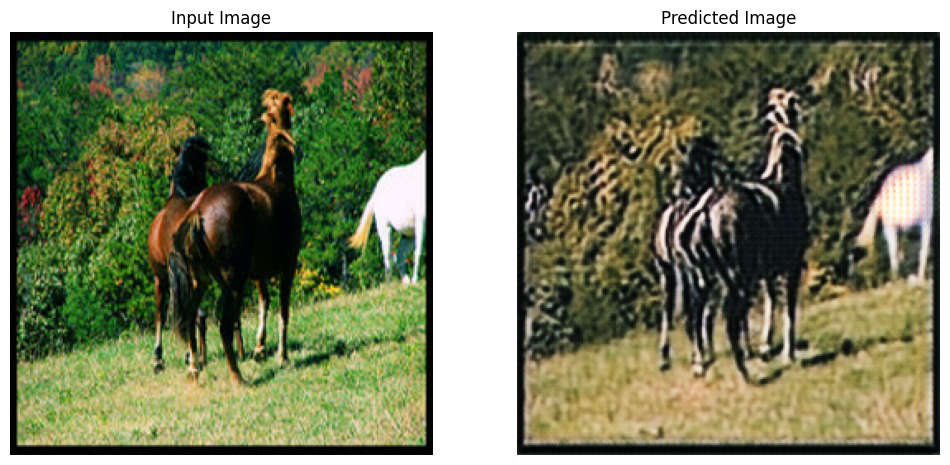

Time taken for epoch 10 is 727.58 sec
Completed training on horse2zebra dataset

Training on monet2photo dataset
Epoch 1/10

Epoch 1: saving model to checkpoints/monet2photo\ckpt.weights.h5
Time taken for epoch 1 is 735.28 sec
Epoch 2/10

Epoch 1: saving model to checkpoints/monet2photo\ckpt.weights.h5
Time taken for epoch 2 is 731.83 sec
Epoch 3/10

Epoch 1: saving model to checkpoints/monet2photo\ckpt.weights.h5
Time taken for epoch 3 is 732.33 sec
Epoch 4/10

Epoch 1: saving model to checkpoints/monet2photo\ckpt.weights.h5
Time taken for epoch 4 is 733.27 sec
Epoch 5/10

Epoch 1: saving model to checkpoints/monet2photo\ckpt.weights.h5
Time taken for epoch 5 is 732.75 sec
Epoch 6/10

Epoch 1: saving model to checkpoints/monet2photo\ckpt.weights.h5
Time taken for epoch 6 is 735.88 sec
Epoch 7/10

Epoch 1: saving model to checkpoints/monet2photo\ckpt.weights.h5
Time taken for epoch 7 is 733.05 sec
Epoch 8/10

Epoch 1: saving model to checkpoints/monet2photo\ckpt.weights.h5
Time taken f

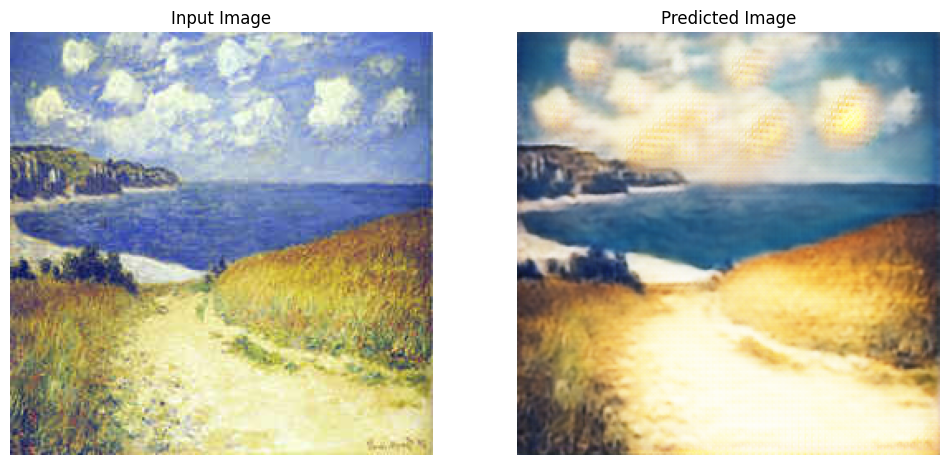

Time taken for epoch 10 is 735.25 sec
Completed training on monet2photo dataset

Training on summer2winter_yosemite dataset
Epoch 1/10

Epoch 1: saving model to checkpoints/summer2winter_yosemite\ckpt.weights.h5
Time taken for epoch 1 is 663.56 sec
Epoch 2/10

Epoch 1: saving model to checkpoints/summer2winter_yosemite\ckpt.weights.h5
Time taken for epoch 2 is 661.18 sec
Epoch 3/10

Epoch 1: saving model to checkpoints/summer2winter_yosemite\ckpt.weights.h5
Time taken for epoch 3 is 661.50 sec
Epoch 4/10

Epoch 1: saving model to checkpoints/summer2winter_yosemite\ckpt.weights.h5
Time taken for epoch 4 is 664.73 sec
Epoch 5/10

Epoch 1: saving model to checkpoints/summer2winter_yosemite\ckpt.weights.h5
Time taken for epoch 5 is 662.53 sec
Epoch 6/10

Epoch 1: saving model to checkpoints/summer2winter_yosemite\ckpt.weights.h5
Time taken for epoch 6 is 659.02 sec
Epoch 7/10

Epoch 1: saving model to checkpoints/summer2winter_yosemite\ckpt.weights.h5
Time taken for epoch 7 is 658.59 sec
E

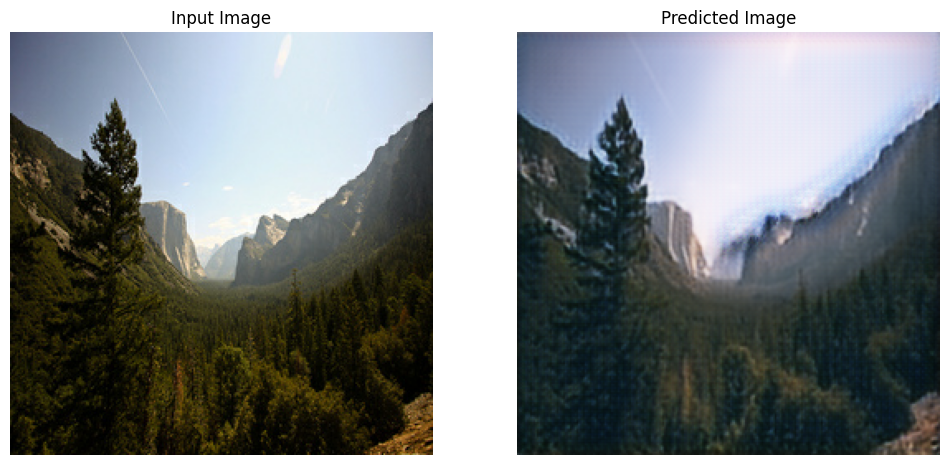

Time taken for epoch 10 is 658.28 sec
Completed training on summer2winter_yosemite dataset

Training on vangogh2photo dataset
Epoch 1/10

Epoch 1: saving model to checkpoints/vangogh2photo\ckpt.weights.h5
Time taken for epoch 1 is 274.93 sec
Epoch 2/10

Epoch 1: saving model to checkpoints/vangogh2photo\ckpt.weights.h5
Time taken for epoch 2 is 273.54 sec
Epoch 3/10

Epoch 1: saving model to checkpoints/vangogh2photo\ckpt.weights.h5
Time taken for epoch 3 is 273.63 sec
Epoch 4/10

Epoch 1: saving model to checkpoints/vangogh2photo\ckpt.weights.h5
Time taken for epoch 4 is 273.94 sec
Epoch 5/10

Epoch 1: saving model to checkpoints/vangogh2photo\ckpt.weights.h5
Time taken for epoch 5 is 274.06 sec
Epoch 6/10

Epoch 1: saving model to checkpoints/vangogh2photo\ckpt.weights.h5
Time taken for epoch 6 is 273.68 sec
Epoch 7/10

Epoch 1: saving model to checkpoints/vangogh2photo\ckpt.weights.h5
Time taken for epoch 7 is 273.56 sec
Epoch 8/10

Epoch 1: saving model to checkpoints/vangogh2photo

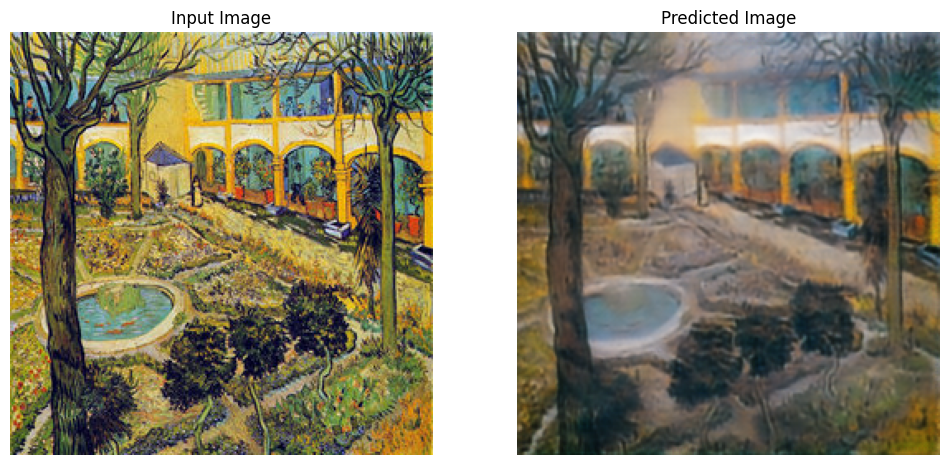

Time taken for epoch 10 is 277.34 sec
Completed training on vangogh2photo dataset

Training on facades dataset
Epoch 1/10

Epoch 1: saving model to checkpoints/facades\ckpt.weights.h5
Time taken for epoch 1 is 274.81 sec
Epoch 2/10

Epoch 1: saving model to checkpoints/facades\ckpt.weights.h5
Time taken for epoch 2 is 274.57 sec
Epoch 3/10

Epoch 1: saving model to checkpoints/facades\ckpt.weights.h5
Time taken for epoch 3 is 285.26 sec
Epoch 4/10

Epoch 1: saving model to checkpoints/facades\ckpt.weights.h5
Time taken for epoch 4 is 276.44 sec
Epoch 5/10

Epoch 1: saving model to checkpoints/facades\ckpt.weights.h5
Time taken for epoch 5 is 271.30 sec
Epoch 6/10

Epoch 1: saving model to checkpoints/facades\ckpt.weights.h5
Time taken for epoch 6 is 271.48 sec
Epoch 7/10

Epoch 1: saving model to checkpoints/facades\ckpt.weights.h5
Time taken for epoch 7 is 272.52 sec
Epoch 8/10

Epoch 1: saving model to checkpoints/facades\ckpt.weights.h5
Time taken for epoch 8 is 274.72 sec
Epoch 9/1

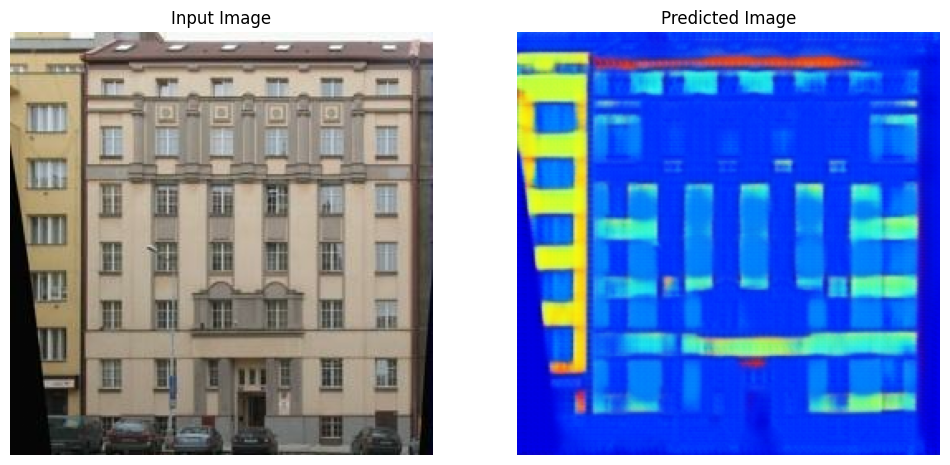

Time taken for epoch 10 is 274.43 sec
Completed training on facades dataset

Training on apple2orange dataset
Epoch 1/10

Epoch 1: saving model to checkpoints/apple2orange\ckpt.weights.h5
Time taken for epoch 1 is 682.08 sec
Epoch 2/10

Epoch 1: saving model to checkpoints/apple2orange\ckpt.weights.h5
Time taken for epoch 2 is 680.35 sec
Epoch 3/10

Epoch 1: saving model to checkpoints/apple2orange\ckpt.weights.h5
Time taken for epoch 3 is 679.50 sec
Epoch 4/10

Epoch 1: saving model to checkpoints/apple2orange\ckpt.weights.h5
Time taken for epoch 4 is 678.97 sec
Epoch 5/10

Epoch 1: saving model to checkpoints/apple2orange\ckpt.weights.h5
Time taken for epoch 5 is 681.64 sec
Epoch 6/10

Epoch 1: saving model to checkpoints/apple2orange\ckpt.weights.h5
Time taken for epoch 6 is 676.07 sec
Epoch 7/10

Epoch 1: saving model to checkpoints/apple2orange\ckpt.weights.h5
Time taken for epoch 7 is 677.71 sec
Epoch 8/10

Epoch 1: saving model to checkpoints/apple2orange\ckpt.weights.h5
Time ta

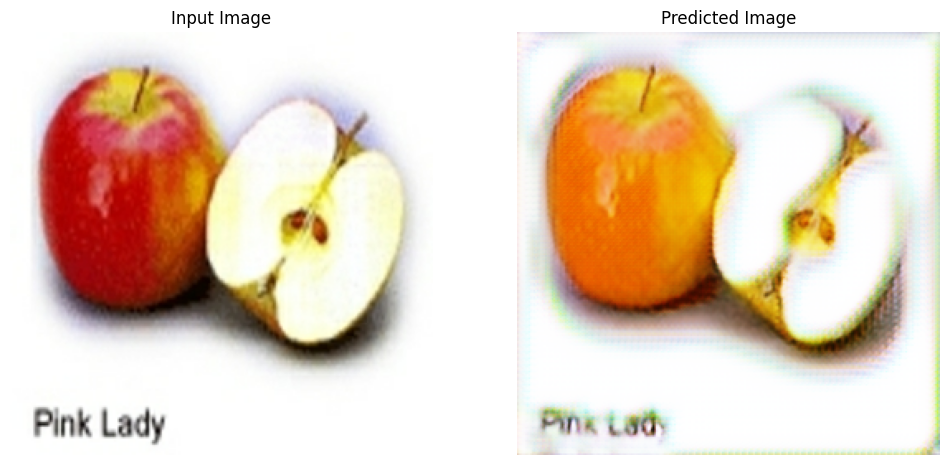

Time taken for epoch 10 is 680.89 sec
Completed training on apple2orange dataset



In [17]:
epochs = 7
epochs_decay = 3

# Loop through each dataset
for dataset_name, paths in dataset_paths.items():
    print(f"Training on {dataset_name} dataset")

    trainA, trainB, testA, testB = prepare_datasets(paths)
    checkpoint_dir = f"checkpoints/{dataset_name}"
    if not os.path.exists(checkpoint_dir):
        os.makedirs(checkpoint_dir)
    checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt.weights.h5")
    latest_checkpoint = tf.train.latest_checkpoint(checkpoint_dir)

    if latest_checkpoint:
        print(f"Loading weights from {latest_checkpoint}, skipping training...")
        generator_g.load_weights(latest_checkpoint)
        generator_f.load_weights(latest_checkpoint)
        discriminator_x.load_weights(latest_checkpoint)
        discriminator_y.load_weights(latest_checkpoint)
    else:
        # Learning rate scheduling
        lr_schedule = lambda epoch: linear_decay_schedule(
            epoch, start_epoch=epochs, n_epochs_decay=epochs_decay
        )

        # Callbacks for checkpointing and learning-rate scheduling
        callbacks = [
            ModelCheckpoint(
                filepath=checkpoint_prefix,
                save_weights_only=True,
                verbose=1,
                save_freq='epoch',
            ),
        ]

        # Training loop | epoch logging | visualization
        for epoch in range(1, epochs + epochs_decay + 1):
            print(f"Epoch {epoch}/{epochs + epochs_decay}")
            start_time = time.time()

            train(
                trainA,
                trainB,
                callbacks,
                epochs=1,
            )

            # Visualize generated images every 10 epochs
            if epoch % 10 == 0:
                for image_x in testA.take(1):
                    generate_images(generator_g, image_x)

            print(f"Time taken for epoch {epoch} is {time.time()-start_time:.2f} sec")
        print(f"Completed training on {dataset_name} dataset\n")


### 3. Model Evaluation

Dataset horse2zebra



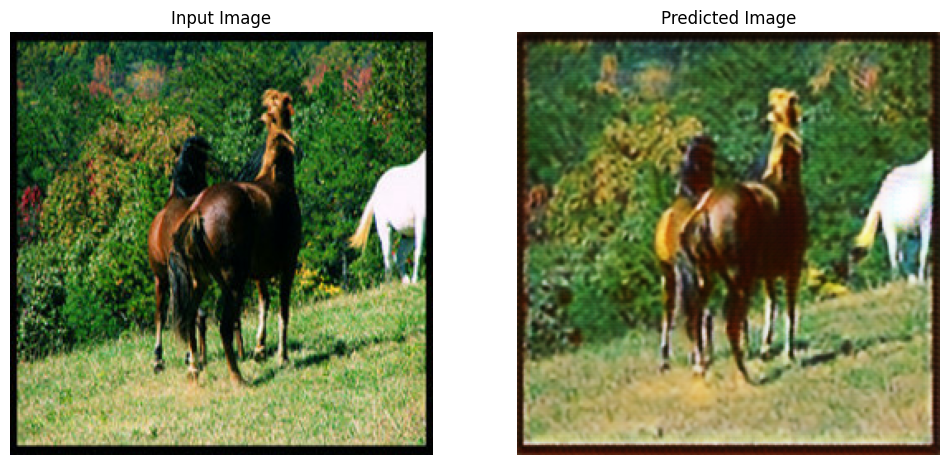

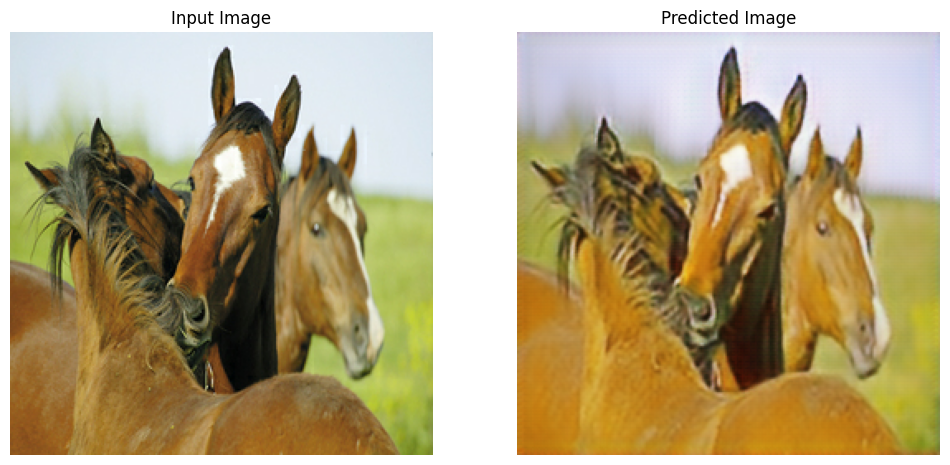

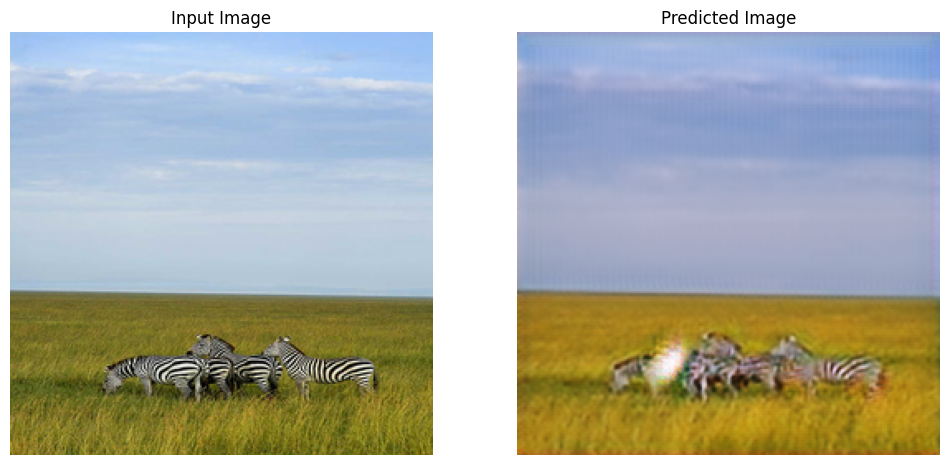

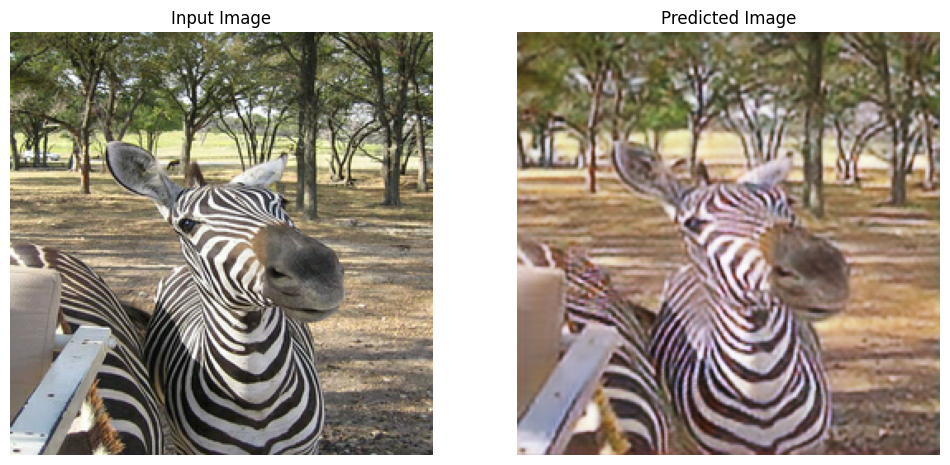

Dataset monet2photo



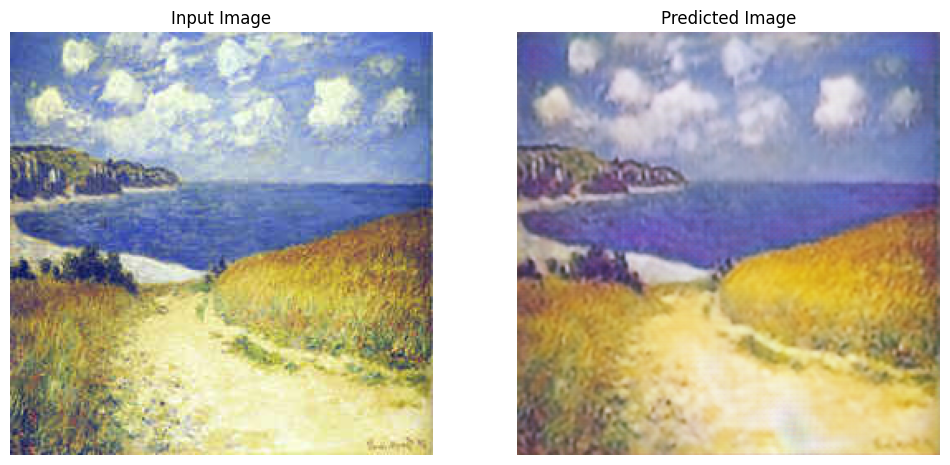

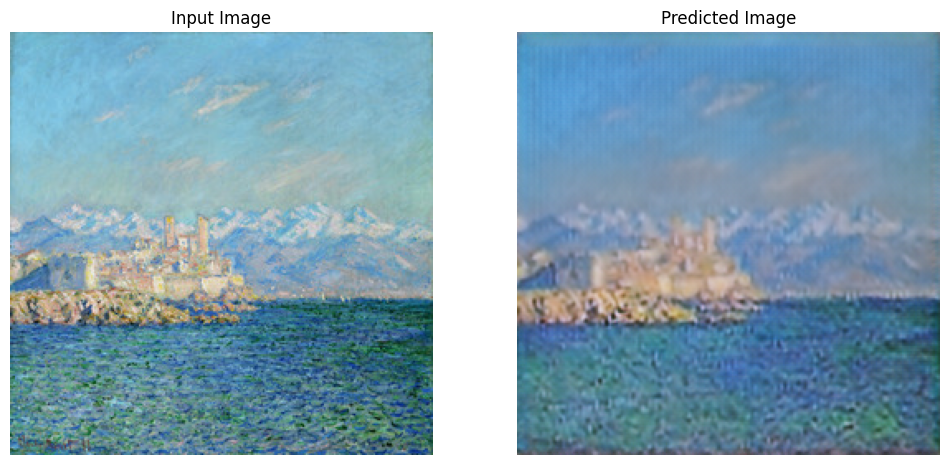

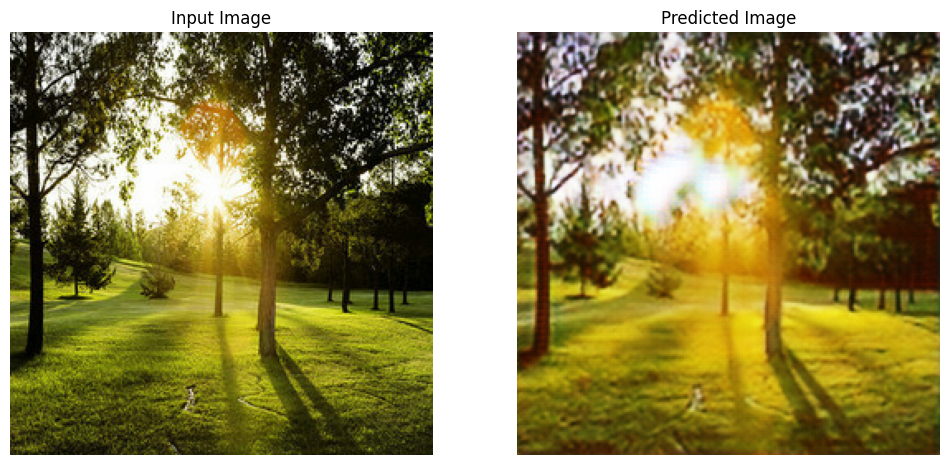

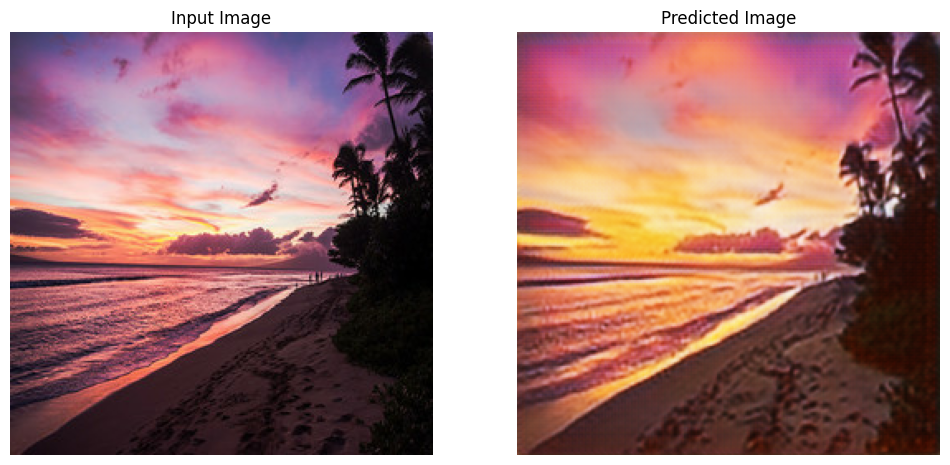

Dataset summer2winter_yosemite



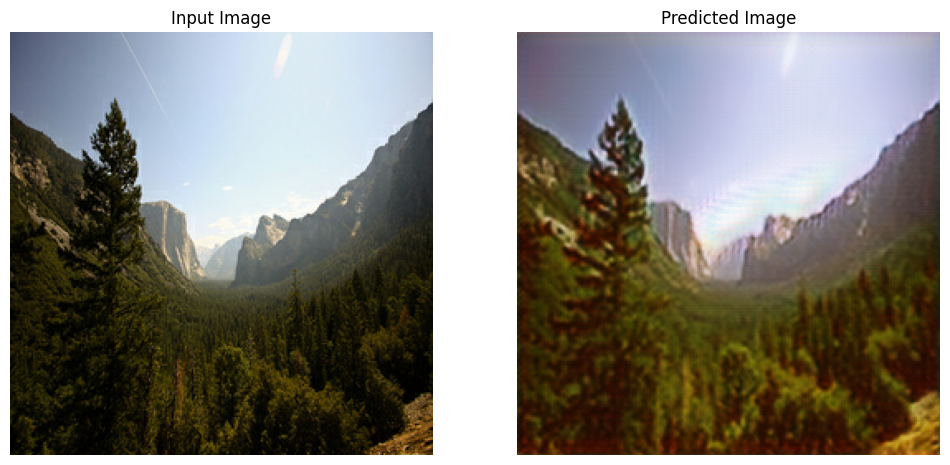

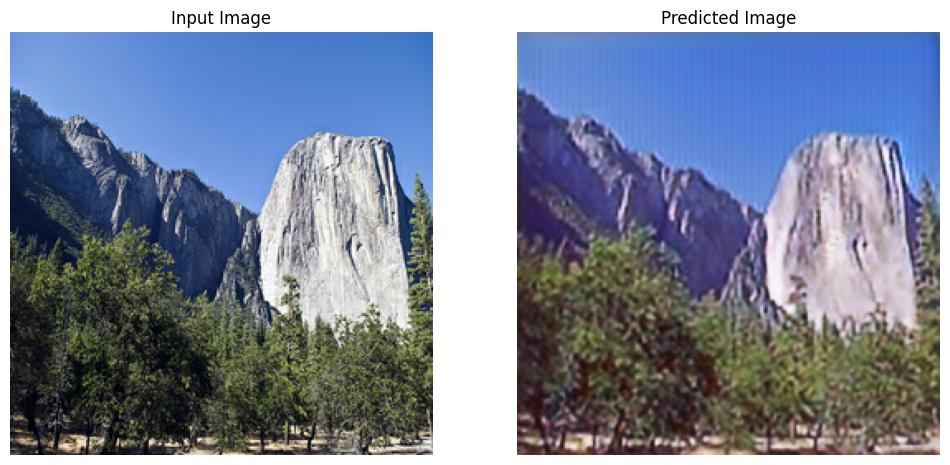

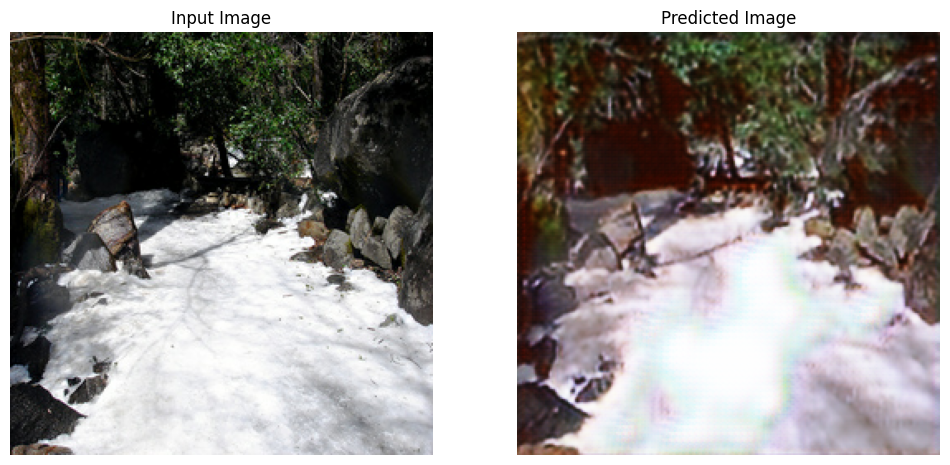

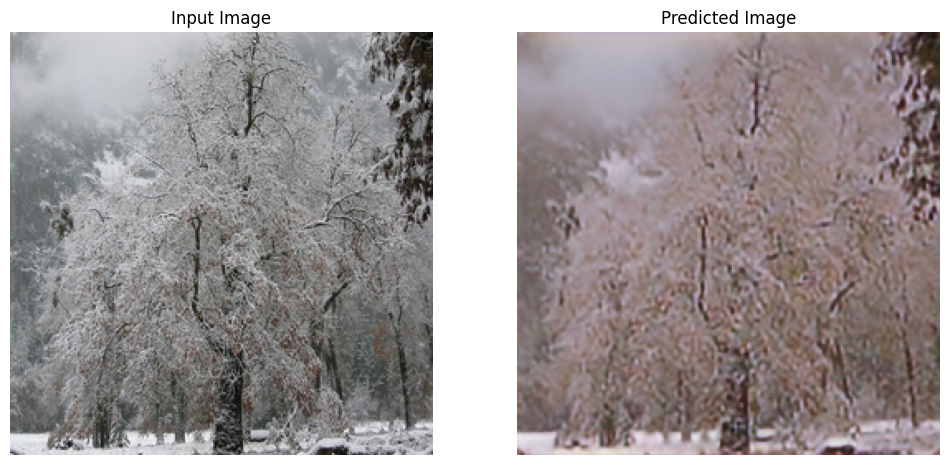

Dataset vangogh2photo



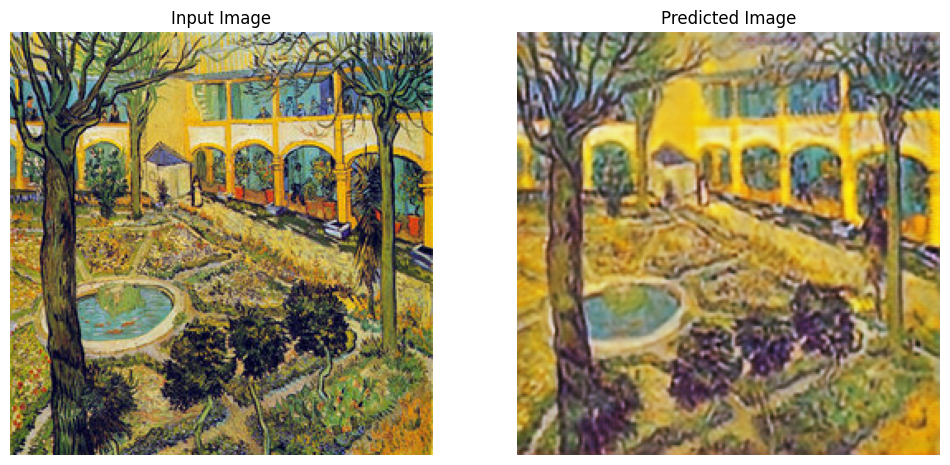

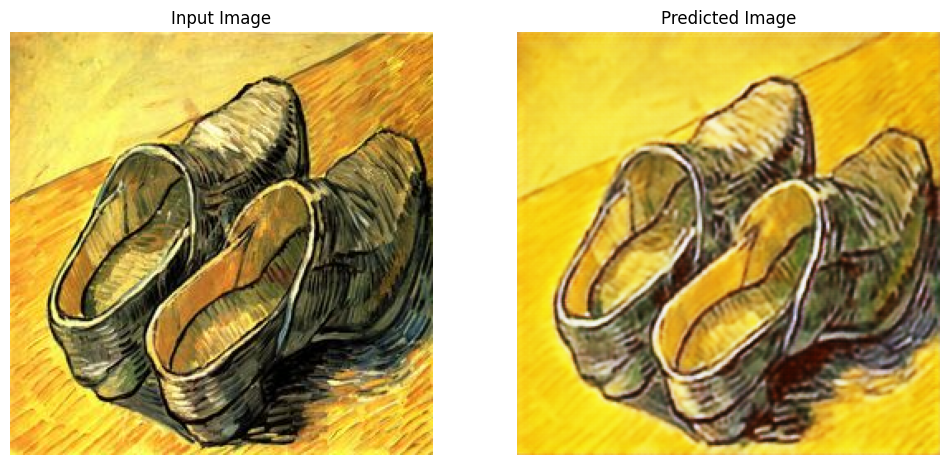

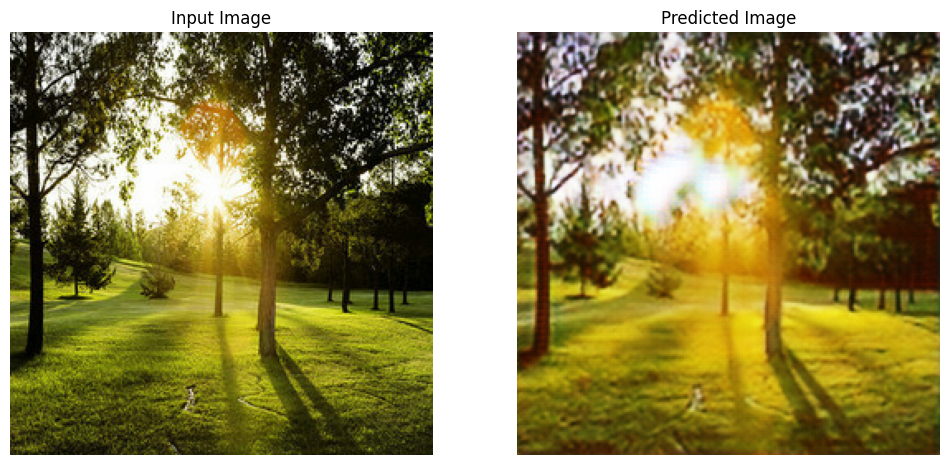

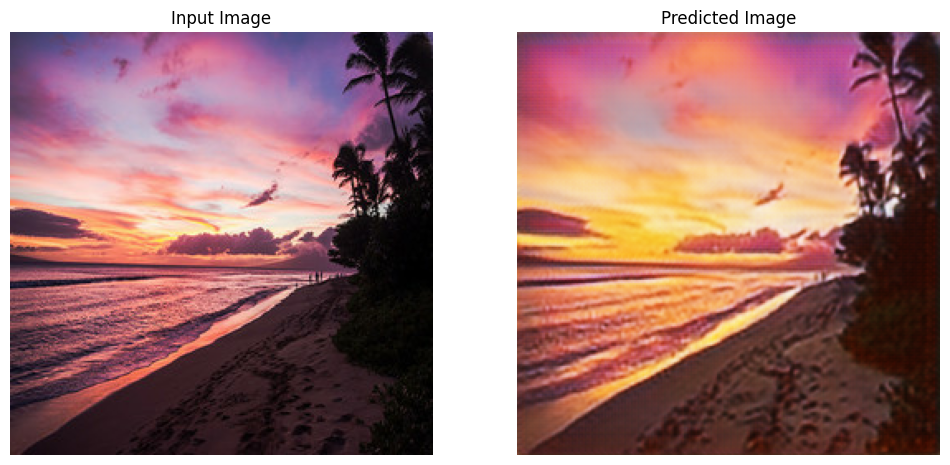

Dataset facades



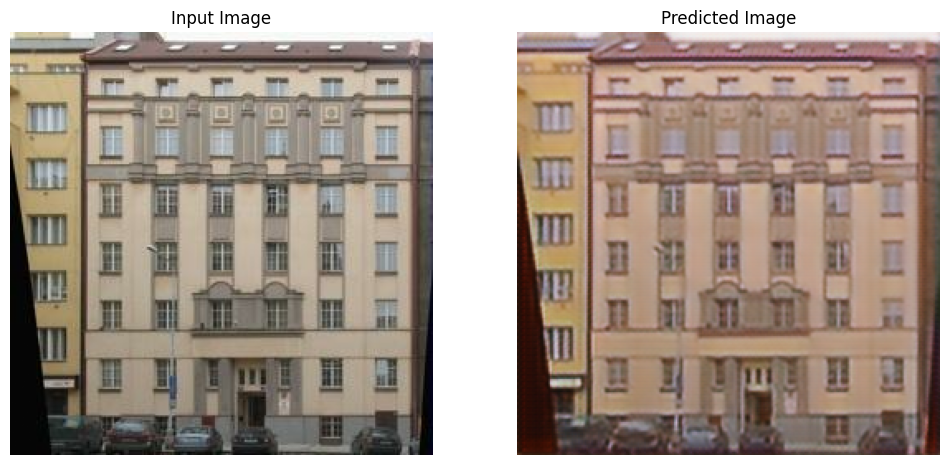

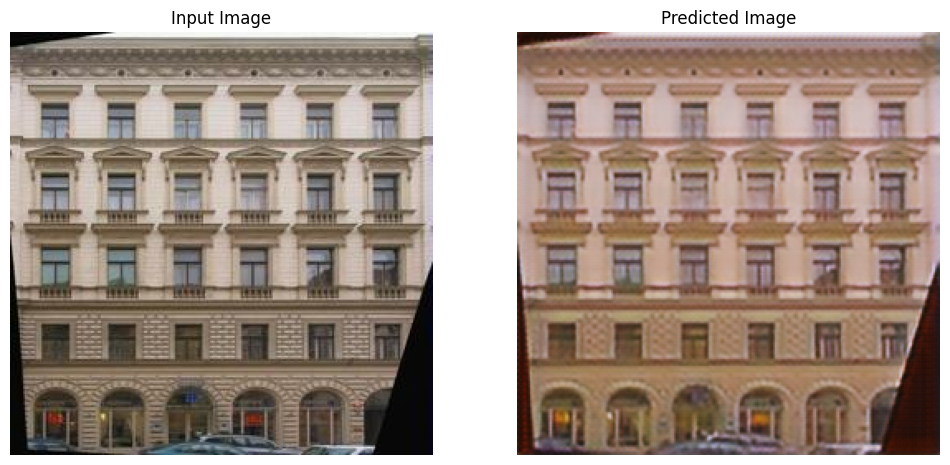

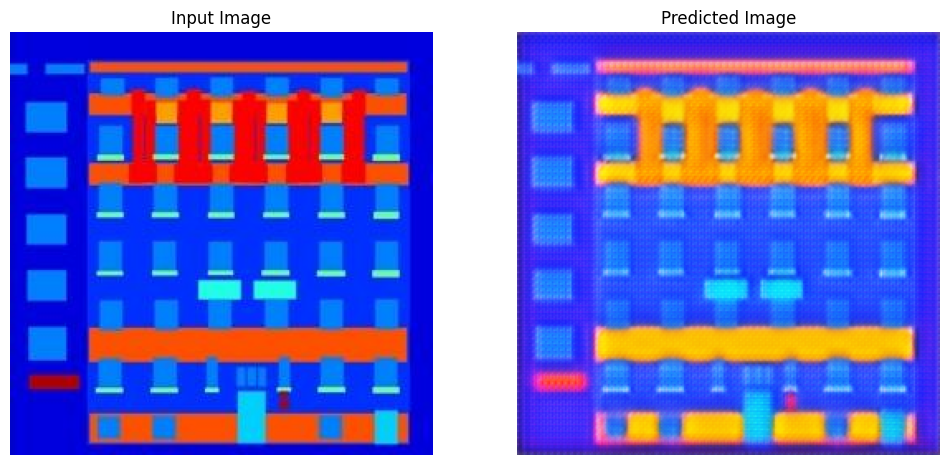

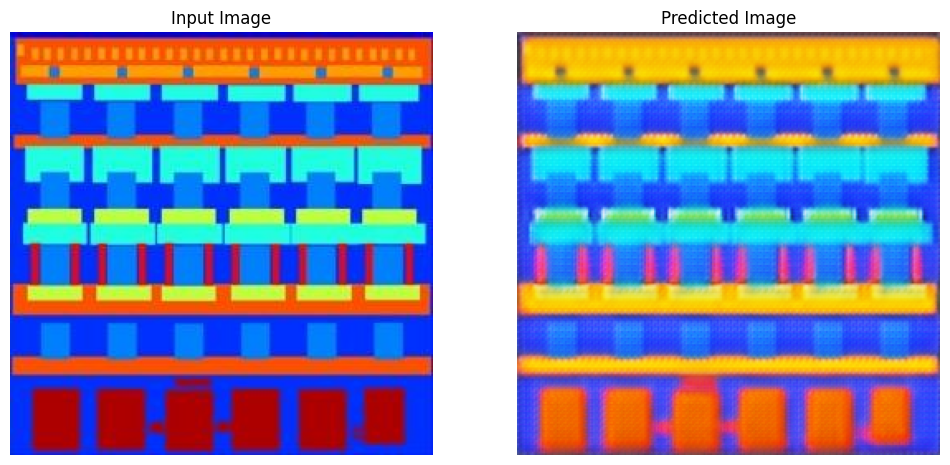

Dataset apple2orange



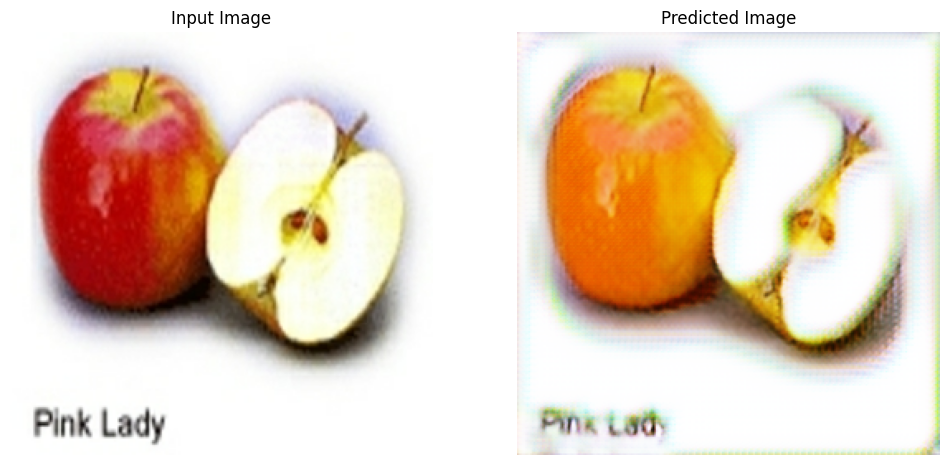

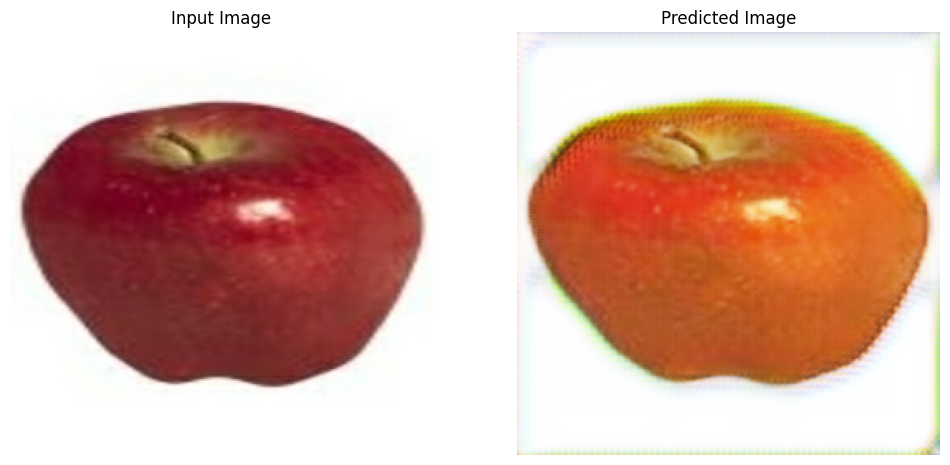

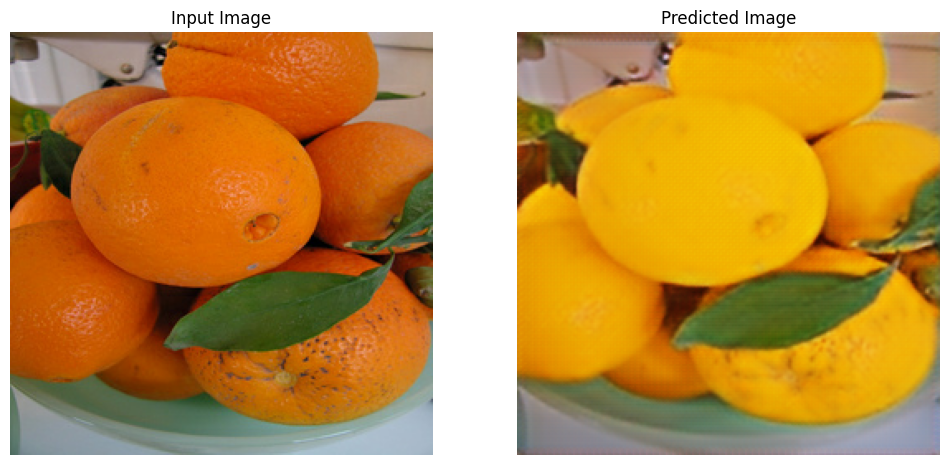

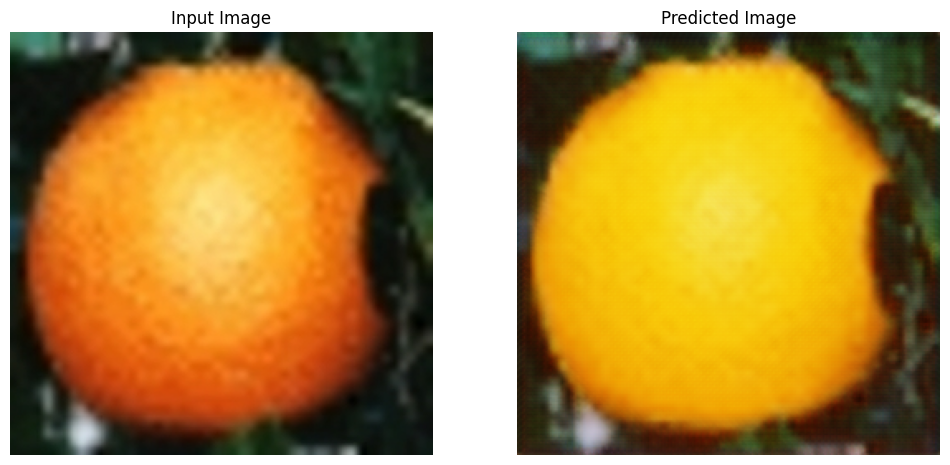

In [ ]:
for dataset_name, paths in dataset_paths.items():
    trainA, trainB, testA, testB = prepare_datasets(paths)

    print(f"Dataset {dataset_name}\n")
    for test_img in testA.take(2):
        generate_images(
            generator_g, test_img
        )  # generator_g: trained model for domain X -> Y

    for test_img in testB.take(2):
        generate_images(
            generator_g, test_img
        )
